In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster

In [2]:
os.chdir('/tscc/projects/ps-palmer/brittany/SUD_cross_species/')

In [31]:
'''wget=list(pd.read_csv('neale_ctrl/sumstats/wget_commands.txt', sep=',',header=None)[0])
f=os.listdir('neale_ctrl/sumstats')
f=[f'wget https://pan-ukb-us-east-1.s3.amazonaws.com/sumstats_flat_files/{x}' for x in f]
wget=set(wget).difference(f)
file_path = "neale_ctrl/sumstats/wget_commands_rerun.txt"
with open(file_path, 'w') as f:
    for item in wget:
        f.write(f"{item}\n")'''

# import manifest

In [238]:
manifest=pd.read_csv('neale_ctrl/Pan-UK Biobank phenotype manifest - phenotype_manifest.tsv',sep='\t',dtype=str)

In [239]:
manifest=manifest[manifest['phenotype_qc_EUR']=='PASS']

In [245]:
manifest['label']=manifest['description']+'('+manifest['coding_description'].fillna('')+'-'+manifest['description_more'].fillna('')+manifest['coding'].fillna('')+')'

In [246]:
manifest[manifest.trait_type=='icd10'][['trait_type','label','phenocode']]

,trait_type,label,phenocode
4663,icd10,E11 Non-insulin-dependent diabetes mellitus(-t...,E11
4678,icd10,E66 Obesity(-truncated: true),E66
4695,icd10,F17 Mental and behavioural disorders due to us...,F17
4702,icd10,F32 Depressive episode(-truncated: true),F32
4732,icd10,G47 Sleep disorders(-truncated: true),G47
4820,icd10,I25 Chronic ischaemic heart disease(-truncated...,I25
4857,icd10,I83 Varicose veins of lower extremities(-trunc...,I83
4887,icd10,J44 Other chronic obstructive pulmonary diseas...,J44
4888,icd10,J45 Asthma(-truncated: true),J45
4915,icd10,K21 Gastro-oesophageal reflux disease(-truncat...,K21


In [6]:
manifest=manifest[~manifest['label'].isna()]

In [11]:
label_subset=manifest['label'].dropna()

In [237]:
len(set(manifest['phenocode']))

325

In [115]:
file_path = "neale_ctrl/phenocodes_to_run_lenient.txt"
with open(file_path, 'w') as f:
    for item in list(manifest['phenocode']):
        f.write(f"{item}\n")

# import heritability table and genetic correlation subset table

In [181]:
h2=pd.read_csv('neale_ctrl/h2_manifest.tsv',sep='\t')

/scratch/bsleger/job_7376765/ipykernel_3769347/1497844989.py:1: DtypeWarning: Columns (3,4,47) have mixed types. Specify dtype option on import or set low_memory=False.
  h2=pd.read_csv('neale_ctrl/h2_manifest.tsv',sep='\t')


In [194]:
#subset heritability table
h2=h2[h2['pop']=='EUR']
h2=h2[h2['qcflags.pass_all']==True]
#h2=h2[h2['estimates.final.h2_observed']>0.1]
h2_phe=set(h2['phenocode'])

# subset the correlation table traits

In [148]:
corr_subset=pd.read_csv('neale_ctrl/subset_corr_lenient.tsv',sep='\t',dtype=str) #corr matrix only for traits that pass H2 qc for european and have h2>0.1

In [149]:
len(set(corr_subset['i_data.phenocode']))

325

In [150]:
corr_subset['j_data.label']=corr_subset['j_data.description']+'('+corr_subset['j_data.coding_description'].fillna('')+'-'+corr_subset['j_data.description_more'].fillna('')+corr_subset['j_data.coding'].fillna('')+')'
corr_subset['i_data.label']=corr_subset['i_data.description']+'('+corr_subset['i_data.coding_description'].fillna('')+'-'+corr_subset['i_data.description_more'].fillna('')+corr_subset['i_data.coding'].fillna('')+')'
corr_subset['comb.label']=corr_subset['i_data.label']+' : '+corr_subset['j_data.label']

In [151]:
len(set(corr_subset['i_data.phenocode']))

325

In [152]:
len(set(corr_subset['j_data.phenocode']))

325

In [190]:
corr_subset.columns

Index(['i', 'j', 'entry', 'i_data.trait_type', 'i_data.phenocode',
       'i_data.pheno_sex', 'i_data.coding', 'i_data.modifier',
       'i_data.n_cases_both_sexes', 'i_data.n_cases_females',
       'i_data.n_cases_males', 'i_data.description', 'i_data.description_more',
       'i_data.coding_description', 'i_data.category', 'j_data.trait_type',
       'j_data.phenocode', 'j_data.pheno_sex', 'j_data.coding',
       'j_data.modifier', 'j_data.n_cases_both_sexes',
       'j_data.n_cases_females', 'j_data.n_cases_males', 'j_data.description',
       'j_data.description_more', 'j_data.coding_description',
       'j_data.category', 'j_data.label', 'i_data.label', 'comb.label'],
      dtype='object')

In [124]:
'''corr_subset=corr_subset[(corr_subset['i_data.label'].isin(label_subset))&(corr_subset['j_data.label'].isin(label_subset))]

corr_subset=corr_subset[(corr_subset['j_data.phenocode'].isin(h2_phe))&(corr_subset['i_data.phenocode'].isin(h2_phe))]'''

In [ ]:
#corr_subset[corr_subset['comb.label'].duplicated()][['entry','comb.label']].to_csv('neale_ctrl/duplicated.csv')

In [160]:
corr_matrix=corr_subset[['i_data.label','j_data.label','entry','comb.label']]

In [161]:
corr_matrix=corr_matrix.drop_duplicates('comb.label')

In [162]:
corr_matrix=corr_matrix.dropna()

In [163]:
corr_matrix['entry']=corr_matrix['entry'].astype(float)

In [170]:
corr_t=corr_matrix.pivot(index='j_data.label',columns='i_data.label',values='entry')

In [172]:
corr_t.to_csv('neale_ctrl/matrix_format.csv',index=False)

In [171]:
corr_t.shape

(3159, 3159)

# plot heatmap

In [166]:
plt.figure(figsize=(12,12))
sns.heatmap(corr_t, fmt='', cmap='coolwarm', center=0,linewidths=0.5, linecolor='gray',square=True)

<Axes: xlabel='i_data.label', ylabel='j_data.label'>

/tscc/nfs/home/bsleger/miniconda3/envs/env-std-py38/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/tscc/nfs/home/bsleger/miniconda3/envs/env-std-py38/lib/python3.8/site-packages/seaborn/matrix.py:1113: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  self._figure.tight_layout(**tight_params)


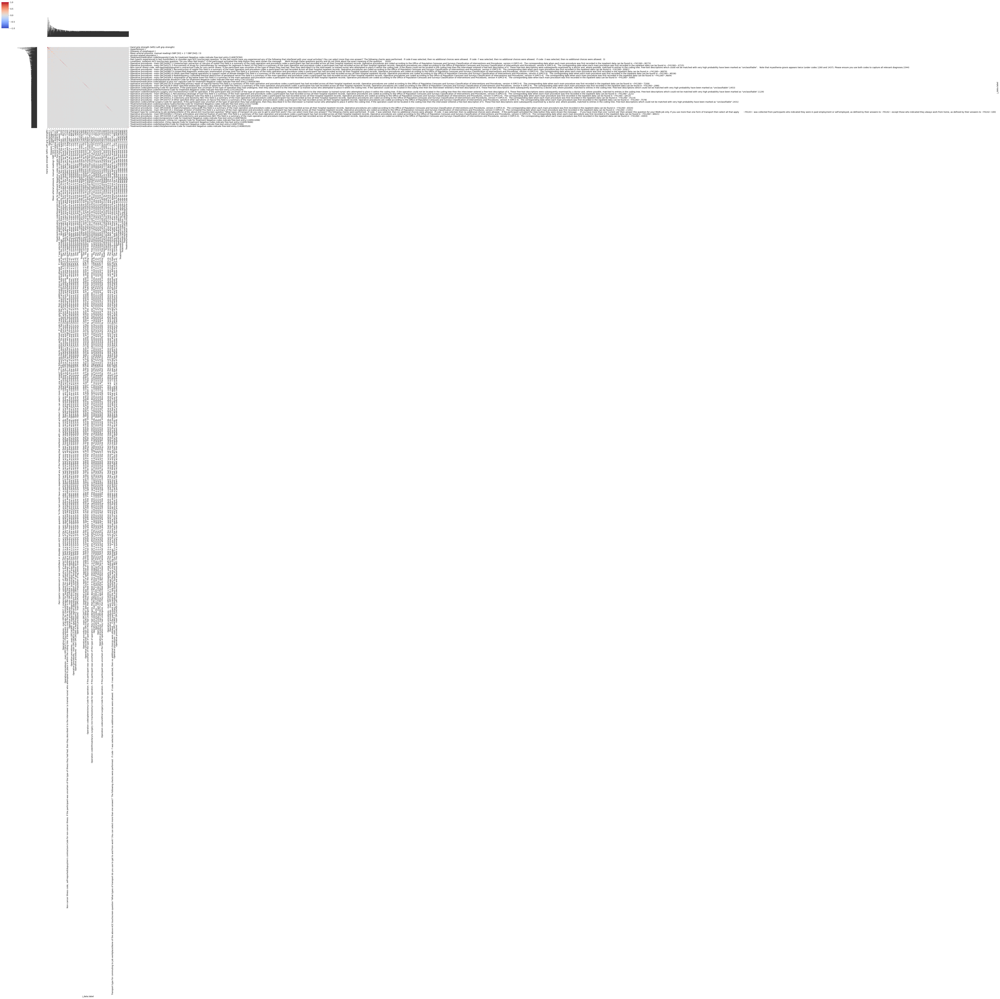

In [180]:
sns.clustermap(corr_t, metric="euclidean", method="average",
               cmap="coolwarm")

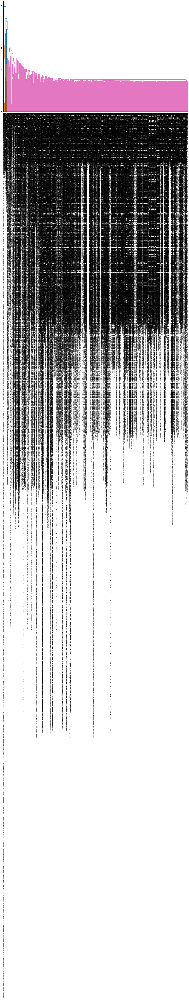

In [176]:
# Hierarchical clustering
plt.figure(figsize=(20,12))
Z= linkage(corr_t, method="average")
dendrogram(Z, labels=corr_t.index)
plt.show()

In [357]:
Z= linkage(corr_t, method="weighted")


In [358]:
# 3. Cut the dendrogram into clusters
# Choose either: 
#   - a number of clusters (t=5), or
#   - a distance threshold (criterion="distance", t=0.5)
clusters = fcluster(Z, t=100, criterion="maxclust")

# 4. Build a table of groupings
groupings = pd.DataFrame({
    "Trait": corr_t.index,
    "Cluster": clusters
}).sort_values("Cluster")

print(groupings)

                                                 Trait  Cluster
294  Impedance of whole body(-Body composition esti...        1
293  Impedance of leg (right)(-Body composition est...        1
292  Impedance of leg (left)(-Body composition esti...        1
291  Impedance of arm (right)(-Body composition est...        1
290  Impedance of arm (left)(-Body composition esti...        1
..                                                 ...      ...
326  Leisure/social activities(Sports club or gym-A...       98
283  Illnesses of siblings(None of the above (group...       99
270  Illnesses of mother(None of the above (group 1...       99
256  Illnesses of father(None of the above (group 1...       99
79   Blood clot, DVT, bronchitis, emphysema, asthma...      100

[3159 rows x 2 columns]


# get heritabilities for groupings

In [359]:
man_mini=manifest[['phenocode','label','trait_type','sldsc_25bin_h2_liability_EUR','trait_efo_categories']]
man_mini.sldsc_25bin_h2_liability_EUR=man_mini.sldsc_25bin_h2_liability_EUR.astype(float)

/scratch/bsleger/job_7376765/ipykernel_3769347/4046929098.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  man_mini.sldsc_25bin_h2_liability_EUR=man_mini.sldsc_25bin_h2_liability_EUR.astype(float)


In [360]:
groupings=groupings.merge(man_mini,left_on='Trait',right_on='label').drop('Trait',axis=1)

In [361]:
groupings=groupings[(groupings.sldsc_25bin_h2_liability_EUR>0.1)]

In [362]:
groupings_sub = groupings.loc[
groupings.groupby("Cluster")["sldsc_25bin_h2_liability_EUR"].idxmax()
].reset_index(drop=True)

In [363]:
groupings_efo = groupings.loc[
    groupings.groupby("trait_efo_categories")["sldsc_25bin_h2_liability_EUR"].idxmax()
].reset_index(drop=True)

In [364]:
groupings.to_csv('neale_ctrl/trait_groupings.csv',index=False)
groupings_sub.to_csv('neale_ctrl/trait_groupings_top.csv',index=False)
groupings_efo.to_csv('neale_ctrl/trait_groupings_efo_top.csv',index=False)

In [373]:
test_traits=pd.concat([groupings_sub,groupings_efo]).drop_duplicates()

# get wget commands

In [374]:
wget=list(manifest[manifest.label.isin(test_traits['label'])]['wget'])

In [377]:
file_path = "neale_ctrl/sumstats/wget_commands.txt"
with open(file_path, 'w') as f:
    for item in wget:
        f.write(f"{item}\n")

In [375]:
wget

['wget https://pan-ukb-us-east-1.s3.amazonaws.com/sumstats_flat_files/biomarkers-30610-both_sexes-irnt.tsv.bgz',
 'wget https://pan-ukb-us-east-1.s3.amazonaws.com/sumstats_flat_files/biomarkers-30670-both_sexes-irnt.tsv.bgz',
 'wget https://pan-ukb-us-east-1.s3.amazonaws.com/sumstats_flat_files/biomarkers-30700-both_sexes-irnt.tsv.bgz',
 'wget https://pan-ukb-us-east-1.s3.amazonaws.com/sumstats_flat_files/biomarkers-30710-both_sexes-irnt.tsv.bgz',
 'wget https://pan-ukb-us-east-1.s3.amazonaws.com/sumstats_flat_files/biomarkers-30720-both_sexes-irnt.tsv.bgz',
 'wget https://pan-ukb-us-east-1.s3.amazonaws.com/sumstats_flat_files/biomarkers-30750-both_sexes-irnt.tsv.bgz',
 'wget https://pan-ukb-us-east-1.s3.amazonaws.com/sumstats_flat_files/biomarkers-30760-both_sexes-irnt.tsv.bgz',
 'wget https://pan-ukb-us-east-1.s3.amazonaws.com/sumstats_flat_files/biomarkers-30770-both_sexes-irnt.tsv.bgz',
 'wget https://pan-ukb-us-east-1.s3.amazonaws.com/sumstats_flat_files/biomarkers-30810-both_sexe

# manifest

In [366]:
set(manifest['trait_type'])

{'biomarkers',
 'categorical',
 'continuous',
 'icd10',
 'phecode',
 'prescriptions'}

In [367]:
manifest[manifest['trait_type']=='icd10']

,trait_type,phenocode,pheno_sex,coding,modifier,description,description_more,coding_description,category,n_cases_full_cohort_both_sexes,...,wget,wget_tabix,md5_hex,size_in_bytes,md5_hex_tabix,size_in_bytes_tabix,trait_efos,trait_efo_terms,trait_efo_categories,label
4663,icd10,E11,both_sexes,NaN,NaN,E11 Non-insulin-dependent diabetes mellitus,truncated: true,NaN,"Chapter IV Endocrine, nutritional and metaboli...",25410,...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,cd2d059ee20ec1358cee087f84ebd4df,2467220673,c97b0c22b49bc028682666e86f4d76f3,2269630,MONDO_0005148,type 2 diabetes mellitus,Digestive system disorder,E11 Non-insulin-dependent diabetes mellitus(-t...
4678,icd10,E66,both_sexes,NaN,NaN,E66 Obesity,truncated: true,NaN,"Chapter IV Endocrine, nutritional and metaboli...",16779,...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,e226a9283e8f7a9ee1bab459eb2791fc,2205448866,2a83e61111eb250497ef905cabe567d3,2214504,EFO_0001073,obesity,Metabolic disorder,E66 Obesity(-truncated: true)
4695,icd10,F17,both_sexes,NaN,NaN,F17 Mental and behavioural disorders due to us...,truncated: true,NaN,Chapter V Mental and behavioural disorders | F...,15597,...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,5f71e339c8d7be6e186d4ea171048858,2372964524,5212249d083445f9c6fd7787acf48fae,2257589,EFO_0003768,nicotine dependence,Neurological disorder,F17 Mental and behavioural disorders due to us...
4702,icd10,F32,both_sexes,NaN,NaN,F32 Depressive episode,truncated: true,NaN,Chapter V Mental and behavioural disorders | F...,16214,...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,869c7f5c85bff350acc2524b64f9257b,2160053302,6dd24230a65aa45b035d8585f1c916a6,2210287,EFO_0003761,unipolar depression,Neurological disorder,F32 Depressive episode(-truncated: true)
4732,icd10,G47,both_sexes,NaN,NaN,G47 Sleep disorders,truncated: true,NaN,Chapter VI Diseases of the nervous system | G4...,6922,...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,bf205bcd0138c88d1952313c07b61072,2096629629,f910efbd7130c80966d182d1f66aac8a,2199909,EFO_0008568,sleep disorder,Neurological disorder,G47 Sleep disorders(-truncated: true)
4820,icd10,I25,both_sexes,NaN,NaN,I25 Chronic ischaemic heart disease,truncated: true,NaN,Chapter IX Diseases of the circulatory system ...,32926,...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,6d2c168640a02b336ecf19358021b3ad,2659255597,745f01d1a1d9c28f4b3d33ad563429d0,2309823,EFO_0001645,coronary artery disease,Cardiovascular disease,I25 Chronic ischaemic heart disease(-truncated...
4857,icd10,I83,both_sexes,NaN,NaN,I83 Varicose veins of lower extremities,truncated: true,NaN,Chapter IX Diseases of the circulatory system ...,12331,...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,6847e603f548c9efb23f81557f74fc85,1844616958,a40f9e35aef6973c27a84b92d9fac655,2143119,HP_0002619,Varicose veins,Other trait,I83 Varicose veins of lower extremities(-trunc...
4887,icd10,J44,both_sexes,NaN,NaN,J44 Other chronic obstructive pulmonary disease,truncated: true,NaN,Chapter X Diseases of the respiratory system |...,11762,...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,787f3a8ce3502a9a8f597a17144e07ae,1827545082,f6d56139df589c75d501395878a86757,2134563,EFO_0000341,chronic obstructive pulmonary disease,Other disease,J44 Other chronic obstructive pulmonary diseas...
4888,icd10,J45,both_sexes,NaN,NaN,J45 Asthma,truncated: true,NaN,Chapter X Diseases of the respiratory system |...,32855,...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,wget https://pan-ukb-us-east-1.s3.amazonaws.co...,93ef78eae918ef0d26ddb4f44f2f6c4b,2682977490,fac5c436c33888bd

#  old code

In [39]:
corrh_sub=corr_head[(corr_head['j_data.phenocode'].isin(h2_phe))]

In [ ]:
corr_head.head()

In [ ]:
corrh_sub[['j_data.phenocode','entry','j_data.description']]

In [ ]:
csub=csub[(~csub['i_data.phenocode'].isin(['random']))&(~csub['i_data.phenocode'].isin(['random']))]

In [ ]:
corr[['i_data.phenocode','j_data.phenocode']]

In [ ]:
len(set(csub['combo'][(csub['combo']).duplicated()]))

In [ ]:
for x in corr['j_data.description_more']:
    print(x)
    print('\n')

In [ ]:
corr[['j_data.phenocode','j_data.description']]

In [ ]:
set(corr['j_data.phenocode']).intersection(h2_phe)

In [ ]:
corr_head['j_data.merge']=corr_headf

In [ ]:
h2['merge']=h2['phenocode'].astype(str)+'_'+h2['coding'].astype(str)

In [ ]:
set(h2['merge']).intersection(corr_head['j_data.merge'])

In [ ]:
corr_phe=[str(x) for x in list(set(corr['j_data.phenocode']))]

In [ ]:
h2['estimates.final.h2_observed'].describe()

In [ ]:
h2[h2['estimates.final.h2_observed']>0.2]

In [ ]:
h2_phe=[ x.replace("'","") for x in h2_phe]

In [ ]:
len(set(h2_phe).intersection(corr_phe))/len(set(h2_phe))

In [ ]:
len(set(h2_phe).intersection(corr_phe))/len(set(corr_phe))

In [ ]:
[x for x in h2.columns if 'ldsc' in x]
(h2['estimates.ldsc.h2_observed']).describe()

In [ ]:
h2[h2['estimates.ldsc.h2_observed']>0.2][['phenocode']]